<a href="https://colab.research.google.com/github/arpitmalhotra009/PySpark/blob/main/Forest_Cover_Classification_Using_PySpark.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installation of Pyspark

In [1]:
!apt-get update > /dev/null
!apt-get install openjdk-8-jdk-headless -qq > /dev/null
#!wget -q http://apache.osuosl.org/spark/spark-2.2.2/spark-2.2.2-bin-hadoop2.7.tgz
#!wget -q http://apache.osuosl.org/spark/spark-2.4.0/spark-2.4.0-bin-hadoop2.7.tgz
#wget -q http://apache.osuosl.org/spark/spark-2.4.5/spark-2.4.5-bin-hadoop2.7.tgz
#!wget -q http://apache.osuosl.org/spark/spark-2.4.6/spark-2.4.6-bin-hadoop2.7.tgz
!wget -q http://apache.osuosl.org/spark/spark-3.0.1/spark-3.0.1-bin-hadoop3.2.tgz
#
# if the current version of Spark is not used, there may be errors
# check here for current versions http://apache.osuosl.org/spark
#
#!tar xf spark-2.4.0-bin-hadoop2.7.tgz
#!tar xf spark-2.4.5-bin-hadoop2.7.tgz
#!tar xf spark-2.4.6-bin-hadoop2.7.tgz
!tar xf spark-3.0.1-bin-hadoop3.2.tgz
!pip install -q findspark

In [2]:
import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
#os.environ["SPARK_HOME"] = "/content/spark-2.4.0-bin-hadoop2.7"
#os.environ["SPARK_HOME"] = "/content/spark-2.4.5-bin-hadoop2.7"
#os.environ["SPARK_HOME"] = "/content/spark-2.4.6-bin-hadoop2.7"
os.environ["SPARK_HOME"] = "/content/spark-3.0.1-bin-hadoop3.2"

# Importing necessary Libraries

In [3]:
import findspark
findspark.init()
import pyspark
from pyspark.sql import SparkSession
from pyspark.ml.feature import StringIndexer, IndexToString
from pyspark.ml.feature import OneHotEncoder
from pyspark.ml.feature import VectorAssembler
from pyspark.ml import Pipeline
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.classification import RandomForestClassifier, DecisionTreeClassifier, LogisticRegression
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
from plotly.offline import plot
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from sklearn.model_selection import train_test_split as tts

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Importing Data

In [5]:
data = pd.read_csv('/content/drive/MyDrive/Forest_Cover/Forest Cover Data.csv')

In [6]:
data.shape

(581012, 55)

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 581012 entries, 0 to 581011
Data columns (total 55 columns):
 #   Column                              Non-Null Count   Dtype
---  ------                              --------------   -----
 0   Elevation                           581012 non-null  int64
 1   Aspect                              581012 non-null  int64
 2   Slope                               581012 non-null  int64
 3   Horizontal_Distance_To_Hydrology    581012 non-null  int64
 4   Vertical_Distance_To_Hydrology      581012 non-null  int64
 5   Horizontal_Distance_To_Roadways     581012 non-null  int64
 6   Hillshade_9am                       581012 non-null  int64
 7   Hillshade_Noon                      581012 non-null  int64
 8   Hillshade_3pm                       581012 non-null  int64
 9   Horizontal_Distance_To_Fire_Points  581012 non-null  int64
 10  Wilderness_Area1                    581012 non-null  int64
 11  Wilderness_Area2                    581012 non-null 

In [8]:
data.head()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,Wilderness_Area1,Wilderness_Area2,Wilderness_Area3,Wilderness_Area4,Soil_Type1,Soil_Type2,Soil_Type3,Soil_Type4,Soil_Type5,Soil_Type6,Soil_Type7,Soil_Type8,Soil_Type9,Soil_Type10,Soil_Type11,Soil_Type12,Soil_Type13,Soil_Type14,Soil_Type15,Soil_Type16,Soil_Type17,Soil_Type18,Soil_Type19,Soil_Type20,Soil_Type21,Soil_Type22,Soil_Type23,Soil_Type24,Soil_Type25,Soil_Type26,Soil_Type27,Soil_Type28,Soil_Type29,Soil_Type30,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,2596,51,3,258,0,510,221,232,148,6279,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,5
1,2590,56,2,212,-6,390,220,235,151,6225,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,5
2,2804,139,9,268,65,3180,234,238,135,6121,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
3,2785,155,18,242,118,3090,238,238,122,6211,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,2
4,2595,45,2,153,-1,391,220,234,150,6172,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,5


In [9]:
df_rec = data.copy()
df_rec['Wilderness_Area'] = df_rec.iloc[:,10:14].idxmax(axis=1)
df_rec['Soil_Type'] = df_rec.iloc[:,14:54].idxmax(axis=1)
df_rec.drop(['Wilderness_Area1',
       'Wilderness_Area2', 'Wilderness_Area3', 'Wilderness_Area4',
       'Soil_Type1', 'Soil_Type2', 'Soil_Type3', 'Soil_Type4', 'Soil_Type5',
       'Soil_Type6', 'Soil_Type7', 'Soil_Type8', 'Soil_Type9', 'Soil_Type10',
       'Soil_Type11', 'Soil_Type12', 'Soil_Type13', 'Soil_Type14',
       'Soil_Type15', 'Soil_Type16', 'Soil_Type17', 'Soil_Type18',
       'Soil_Type19', 'Soil_Type20', 'Soil_Type21', 'Soil_Type22',
       'Soil_Type23', 'Soil_Type24', 'Soil_Type25', 'Soil_Type26',
       'Soil_Type27', 'Soil_Type28', 'Soil_Type29', 'Soil_Type30',
       'Soil_Type31', 'Soil_Type32', 'Soil_Type33', 'Soil_Type34',
       'Soil_Type35', 'Soil_Type36', 'Soil_Type37', 'Soil_Type38',
       'Soil_Type39', 'Soil_Type40'], axis =1, inplace=True)
df_rec.head()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,Cover_Type,Wilderness_Area,Soil_Type
0,2596,51,3,258,0,510,221,232,148,6279,5,Wilderness_Area1,Soil_Type29
1,2590,56,2,212,-6,390,220,235,151,6225,5,Wilderness_Area1,Soil_Type29
2,2804,139,9,268,65,3180,234,238,135,6121,2,Wilderness_Area1,Soil_Type12
3,2785,155,18,242,118,3090,238,238,122,6211,2,Wilderness_Area1,Soil_Type30
4,2595,45,2,153,-1,391,220,234,150,6172,5,Wilderness_Area1,Soil_Type29


In [10]:
idx_to_covertype = {1:'Spruce/Fir', 2:'Lodgepole Pine', 3:'Ponderosa Pine', 4:'Cottonwood/Willow', 5:'Aspen', 6:'Douglas-fir', 7:'Krummholz'}
covertype_to_idx = {'Spruce/Fir':1, 'Lodgepole Pine':2, 'Ponderosa Pine':3, 'Cottonwood/Willow':4, 'Aspen':5, 'Douglas-fir':6, 'Krummholz':7}
idx_to_wilder = {"Wilderness_Area1":"Rawah_WA","Wilderness_Area2":"Neota_WA","Wilderness_Area3":"Comanche_Peak_WA","Wilderness_Area4":"Cache_la_Poudre_WA"}
wilder_to_idx = {"Rawah_WA":"Wilderness_Area1","Neota_WA":"Wilderness_Area2", "Comanche_Peak_WA":"Wilderness_Area3","Cache_la_Poudre_WA":"Wilderness_Area4"}

In [11]:
df_rec['Cover_Type'] = df_rec['Cover_Type'].map(idx_to_covertype)
df_rec['Wilderness_Area'] = df_rec['Wilderness_Area'].map(idx_to_wilder)

In [12]:
df_rec = df_rec[['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points', 'Wilderness_Area',
       'Soil_Type','Cover_Type']]

# Splitting the data in Training, Validation and Test Set

In [13]:
X, X_test = tts(df_rec, stratify=df_rec.Cover_Type, test_size = 0.5, random_state = 32)

In [14]:
X_train, X_valid = tts(X, stratify=X.Cover_Type, test_size = 0.5 , random_state = 32)

In [15]:
X_train.to_csv('forest_train.csv')
X_valid.to_csv('forest_valid.csv')
X_test.to_csv('forest_test.csv')

# Descriptive Statistics

In [16]:
X_train.describe()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points
count,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000
mean,2959.297839,155.682086,14.078752,269.407868,46.442283,2349.848809,212.183535,223.353432,142.541345,1983.302844
std,279.921324,111.948157,7.489276,211.930626,58.182778,1557.877775,26.796037,19.695759,38.250747,1328.769287
min,1859.000000,0.000000,0.000000,0.000000,-159.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2810.000000,59.000000,9.000000,108.000000,7.000000,1106.000000,198.000000,213.000000,119.000000,1022.000000
50%,2995.000000,127.000000,13.000000,218.000000,30.000000,1998.000000,218.000000,226.000000,143.000000,1712.000000
75%,3163.000000,261.000000,18.000000,384.000000,69.000000,3330.000000,231.000000,237.000000,168.000000,2550.000000
max,3858.000000,360.000000,65.000000,1390.000000,597.000000,7112.000000,254.000000,254.000000,253.000000,7168.000000


In [17]:
X_valid.describe()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points
count,145253.000000,145253.000000,145253.00000,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000,145253.000000
mean,2959.468245,155.567871,14.08784,270.301281,46.554990,2350.921193,212.153422,223.350017,142.553655,1980.490289
std,279.967547,111.789150,7.48665,213.300371,58.494433,1558.673061,26.780980,19.731075,38.349865,1322.155458
min,1860.000000,0.000000,0.00000,0.000000,-159.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2809.000000,58.000000,9.00000,108.000000,7.000000,1106.000000,198.000000,213.000000,119.000000,1026.000000
50%,2995.000000,127.000000,13.00000,218.000000,30.000000,1998.000000,218.000000,226.000000,143.000000,1712.000000
75%,3164.000000,260.000000,18.00000,390.000000,69.000000,3327.000000,231.000000,237.000000,168.000000,2550.000000
max,3849.000000,360.000000,64.00000,1390.000000,598.000000,7092.000000,254.000000,254.000000,254.000000,7141.000000


In [18]:
X_test.describe()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points
count,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000
mean,2959.347559,155.688636,14.124111,269.001859,46.339074,2349.908222,212.123619,223.285708,142.509026,1978.685886
std,280.025976,111.959103,7.488489,212.481495,58.251682,1560.238889,26.751324,19.823828,38.248825,1322.924572
min,1866.000000,0.000000,0.000000,0.000000,-173.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2809.000000,58.000000,9.000000,108.000000,7.000000,1104.000000,198.000000,213.000000,119.000000,1022.000000
50%,2996.000000,127.000000,13.000000,218.000000,29.000000,1995.000000,218.000000,226.000000,143.000000,1708.000000
75%,3164.000000,260.000000,18.000000,384.000000,69.000000,3327.750000,231.000000,237.000000,168.000000,2550.000000
max,3858.000000,360.000000,66.000000,1397.000000,601.000000,7117.000000,254.000000,254.000000,254.000000,7173.000000


# Exploratory Data Analysis

In [19]:
fig = px.histogram(X_train,x="Cover_Type",color="Cover_Type",height=400,width=800, "Distribution of Cover Types")
fig.show()

fig = px.pie(X_train,names="Cover_Type", width = 1000, title='Percentage Distribution of Cover Types')
fig.show()

In [20]:
fig = px.pie(X_train,names="Wilderness_Area", width = 1000)
fig.show()

In [21]:
fig = px.histogram(X_train,x="Wilderness_Area",color="Cover_Type",barmode="group")
fig.show()

In [22]:
fig = px.histogram(X_train,x="Soil_Type",color="Cover_Type",width=1200)
fig.show()

In [23]:
fig = px.pie(X_train,names="Soil_Type",width=1200 )
fig.update_traces(textposition='inside')
fig.show()

In [24]:
temp =X_train[X_train['Wilderness_Area']=="Rawah_WA"][['Wilderness_Area','Soil_Type',"Cover_Type"]]
fig = px.histogram(temp,x="Soil_Type",color="Cover_Type",height=500,width=1000,
                  title="Rawah Wild Area",barmode="group")
fig.show()

temp = X_train[X_train['Wilderness_Area']=="Comanche_Peak_WA"][['Wilderness_Area','Soil_Type',"Cover_Type"]]
fig = px.histogram(temp,x="Soil_Type",color="Cover_Type",height=500,width=1000,
                  title="Comanche Peak Area",barmode="group")
fig.show()

temp =X_train[X_train['Wilderness_Area']=="Cache_la_Poudre_WA"][['Wilderness_Area','Soil_Type',"Cover_Type"]]
fig = px.histogram(temp,x="Soil_Type",color="Cover_Type",height=500,width=1000,
                  title="Cache la Poudre Wild Area",barmode="group")
fig.show()

temp =X_train[X_train['Wilderness_Area']=="Neota_WA"][['Wilderness_Area','Soil_Type',"Cover_Type"]]
fig = px.histogram(temp,x="Soil_Type",color="Cover_Type",height=500,width=1000,
                  title="Neota Wild Area",barmode="group")
fig.show()

In [25]:
fig = px.histogram(X_train,x="Elevation",color="Cover_Type",marginal='box',title="Elevation Histogram",
                  height=500,width=800)
fig.show()

In [26]:
fig = px.histogram(X_train,x="Slope",color="Cover_Type",marginal='box',title="Slope Histogram",
                  height=500,width=800)
fig.show()

In [27]:
fig = px.histogram(X_train,x="Aspect",color="Cover_Type",marginal='box',title="Aspect Histogram",
                  height=500,width=800)
fig.show()

In [28]:
fig = px.histogram(X_train,x="Horizontal_Distance_To_Hydrology",color="Cover_Type",marginal='box',title="Horizontal_Distance_To_Hydrology  Histogram",
                  height=500,width=800)
fig.show()

In [29]:
fig = px.histogram(X_train,x="Vertical_Distance_To_Hydrology",color="Cover_Type",marginal='box',title="Vertical_Distance_To_Hydrology  Histogram",
                  height=500,width=800)
fig.show()

In [30]:

fig = px.histogram(X_train,x="Horizontal_Distance_To_Fire_Points",color="Cover_Type",marginal='box',title="Horizontal_Distance_To_Fire_Points Histogram",
                  height=500,width=800)
fig.show()

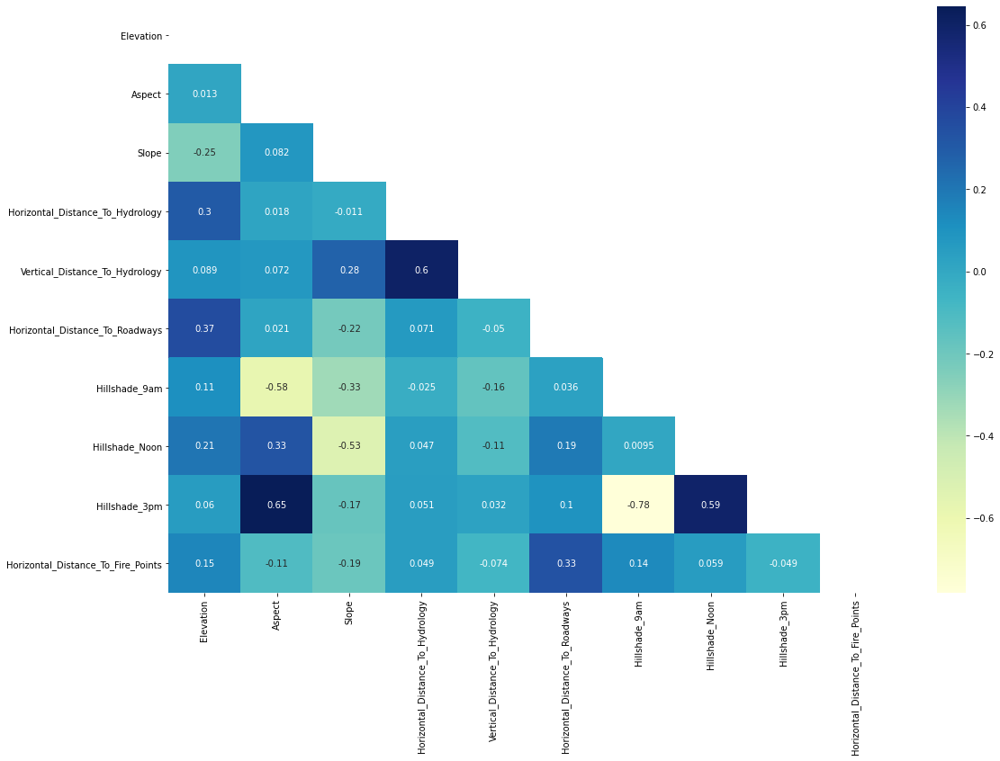

In [31]:
plt.figure(figsize=(18,12))
corr_matrix=X_train.corr()
mask = np.zeros_like(corr_matrix)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corr_matrix,annot=True ,cbar = True,cmap="YlGnBu",mask=mask)

# Initializing Spark Session

In [32]:
spark = SparkSession.builder.master("local[*]").getOrCreate()

In [33]:
sc = spark.sparkContext
sc

<SparkContext master=local[*] appName=pyspark-shell>

# Importing Data in Pyspark Dataframe

In [34]:
df_train = spark.read.csv('forest_train.csv', header = True, inferSchema=True)
df_test = spark.read.csv('forest_test.csv', header = True, inferSchema=True)
df_valid = spark.read.csv('forest_valid.csv', header = True, inferSchema=True)

In [35]:
df_train.show(5, False)

+------+---------+------+-----+--------------------------------+------------------------------+-------------------------------+-------------+--------------+-------------+----------------------------------+------------------+-----------+--------------+
|_c0   |Elevation|Aspect|Slope|Horizontal_Distance_To_Hydrology|Vertical_Distance_To_Hydrology|Horizontal_Distance_To_Roadways|Hillshade_9am|Hillshade_Noon|Hillshade_3pm|Horizontal_Distance_To_Fire_Points|Wilderness_Area   |Soil_Type  |Cover_Type    |
+------+---------+------+-----+--------------------------------+------------------------------+-------------------------------+-------------+--------------+-------------+----------------------------------+------------------+-----------+--------------+
|276644|2352     |285   |22   |541                             |214                           |598                            |153          |233           |218          |1650                              |Cache_la_Poudre_WA|Soil_Type10|Ponderos

In [36]:
df_test.show(5, False)

+------+---------+------+-----+--------------------------------+------------------------------+-------------------------------+-------------+--------------+-------------+----------------------------------+------------------+-----------+--------------+
|_c0   |Elevation|Aspect|Slope|Horizontal_Distance_To_Hydrology|Vertical_Distance_To_Hydrology|Horizontal_Distance_To_Roadways|Hillshade_9am|Hillshade_Noon|Hillshade_3pm|Horizontal_Distance_To_Fire_Points|Wilderness_Area   |Soil_Type  |Cover_Type    |
+------+---------+------+-----+--------------------------------+------------------------------+-------------------------------+-------------+--------------+-------------+----------------------------------+------------------+-----------+--------------+
|457162|3066     |34    |12   |201                             |49                            |1348                           |218          |214           |130          |2949                              |Comanche_Peak_WA  |Soil_Type31|Spruce/F

In [37]:
df_train.printSchema()

root
 |-- _c0: integer (nullable = true)
 |-- Elevation: integer (nullable = true)
 |-- Aspect: integer (nullable = true)
 |-- Slope: integer (nullable = true)
 |-- Horizontal_Distance_To_Hydrology: integer (nullable = true)
 |-- Vertical_Distance_To_Hydrology: integer (nullable = true)
 |-- Horizontal_Distance_To_Roadways: integer (nullable = true)
 |-- Hillshade_9am: integer (nullable = true)
 |-- Hillshade_Noon: integer (nullable = true)
 |-- Hillshade_3pm: integer (nullable = true)
 |-- Horizontal_Distance_To_Fire_Points: integer (nullable = true)
 |-- Wilderness_Area: string (nullable = true)
 |-- Soil_Type: string (nullable = true)
 |-- Cover_Type: string (nullable = true)



In [38]:
#dropping index Column
df_train = df_train.drop('_c0')
df_test = df_test.drop('_c0')
df_valid = df_valid.drop('_c0')
df_train.printSchema()

root
 |-- Elevation: integer (nullable = true)
 |-- Aspect: integer (nullable = true)
 |-- Slope: integer (nullable = true)
 |-- Horizontal_Distance_To_Hydrology: integer (nullable = true)
 |-- Vertical_Distance_To_Hydrology: integer (nullable = true)
 |-- Horizontal_Distance_To_Roadways: integer (nullable = true)
 |-- Hillshade_9am: integer (nullable = true)
 |-- Hillshade_Noon: integer (nullable = true)
 |-- Hillshade_3pm: integer (nullable = true)
 |-- Horizontal_Distance_To_Fire_Points: integer (nullable = true)
 |-- Wilderness_Area: string (nullable = true)
 |-- Soil_Type: string (nullable = true)
 |-- Cover_Type: string (nullable = true)



In [39]:
df_train.describe().show()

+-------+------------------+------------------+------------------+--------------------------------+------------------------------+-------------------------------+------------------+-----------------+-----------------+----------------------------------+------------------+----------+----------+
|summary|         Elevation|            Aspect|             Slope|Horizontal_Distance_To_Hydrology|Vertical_Distance_To_Hydrology|Horizontal_Distance_To_Roadways|     Hillshade_9am|   Hillshade_Noon|    Hillshade_3pm|Horizontal_Distance_To_Fire_Points|   Wilderness_Area| Soil_Type|Cover_Type|
+-------+------------------+------------------+------------------+--------------------------------+------------------------------+-------------------------------+------------------+-----------------+-----------------+----------------------------------+------------------+----------+----------+
|  count|            145253|            145253|            145253|                          145253|                   

In [40]:
df_test.describe().show()

+-------+-----------------+------------------+-----------------+--------------------------------+------------------------------+-------------------------------+------------------+------------------+------------------+----------------------------------+------------------+----------+----------+
|summary|        Elevation|            Aspect|            Slope|Horizontal_Distance_To_Hydrology|Vertical_Distance_To_Hydrology|Horizontal_Distance_To_Roadways|     Hillshade_9am|    Hillshade_Noon|     Hillshade_3pm|Horizontal_Distance_To_Fire_Points|   Wilderness_Area| Soil_Type|Cover_Type|
+-------+-----------------+------------------+-----------------+--------------------------------+------------------------------+-------------------------------+------------------+------------------+------------------+----------------------------------+------------------+----------+----------+
|  count|           290506|            290506|           290506|                          290506|                     

# Buiilding Machine Learning Pipeline



In [41]:
indexer = StringIndexer(inputCols = ['Wilderness_Area', 'Soil_Type', 'Cover_Type'], outputCols = ['Wilderness_Area_idx', 'Soil_Type_idx', 'Cover_Type_idx'] )

onehot = OneHotEncoder(inputCols = ['Wilderness_Area_idx', 'Soil_Type_idx'], outputCols = ['Wilderness_Area_dummy', 'Soil_Type_dummy'] )

assembler = VectorAssembler(inputCols=['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 
                                       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways','Hillshade_9am','Hillshade_Noon', 'Hillshade_3pm',
                                       'Horizontal_Distance_To_Fire_Points', 'Wilderness_Area_dummy', 'Soil_Type_dummy' ], outputCol='features')

labelConverter = IndexToString(inputCol="prediction", outputCol="predictedLabel")



tree = DecisionTreeClassifier(labelCol = 'Cover_Type_idx')



forest = RandomForestClassifier(labelCol='Cover_Type_idx', numTrees = 130, maxDepth = 10)



lr = LogisticRegression(maxIter=50, regParam=0.3, elasticNetParam=0.8,labelCol = 'Cover_Type_idx')

In [42]:
pipeline_tree = Pipeline(stages=[indexer, onehot, assembler, tree])

pipeline_forest = Pipeline(stages=[indexer, onehot, assembler, forest])

pipeline_lr = Pipeline(stages=[indexer, onehot, assembler, lr])

In [43]:
pipeline_tree = pipeline_tree.fit(df_train)

In [44]:
pipeline_forest = pipeline_forest.fit(df_train)

In [45]:
pipeline_lr = pipeline_lr.fit(df_train)

# Evaluation

## Feature Importances

In [63]:
pipeline_forest.stages[3].featureImportances

SparseVector(52, {0: 0.4221, 1: 0.0098, 2: 0.0086, 3: 0.0159, 4: 0.0116, 5: 0.047, 6: 0.0107, 7: 0.0138, 8: 0.0074, 9: 0.0324, 10: 0.0227, 11: 0.0177, 12: 0.0977, 13: 0.0075, 14: 0.0199, 15: 0.0047, 16: 0.0011, 17: 0.0363, 18: 0.0307, 19: 0.034, 20: 0.0034, 21: 0.0016, 22: 0.001, 23: 0.0056, 24: 0.0261, 25: 0.0236, 26: 0.0326, 27: 0.0027, 28: 0.0005, 29: 0.0114, 30: 0.0213, 31: 0.0058, 32: 0.0036, 33: 0.0002, 34: 0.0013, 35: 0.0034, 36: 0.0001, 37: 0.0001, 38: 0.0013, 39: 0.0005, 40: 0.0006, 41: 0.0002, 42: 0.0001, 43: 0.0001, 44: 0.0004, 45: 0.0, 46: 0.0003, 47: 0.0001, 48: 0.0003, 49: 0.0, 50: 0.0, 51: 0.0})

## Predicting on Validation Data

In [46]:
prediction_tree = pipeline_tree.transform(df_valid)

In [47]:
prediction_forest = pipeline_forest.transform(df_valid)

In [48]:
prediction_lr = pipeline_lr.transform(df_valid)

In [49]:
evaluator = MulticlassClassificationEvaluator(labelCol='Cover_Type_idx')

## Evaluating on Validation Data

In [50]:
evaluator.evaluate(prediction_tree, {evaluator.metricName: 'weightedFMeasure'})

0.6870686992014972

In [51]:
evaluator.evaluate(prediction_forest, {evaluator.metricName: 'weightedFMeasure'})

0.7187527737163175

In [52]:
evaluator.evaluate(prediction_lr, {evaluator.metricName: 'weightedFMeasure'})

0.3196446940422085

In [53]:
evaluator.evaluate(prediction_tree, {evaluator.metricName: 'accuracy'})

0.7036205792651443

In [54]:
evaluator.evaluate(prediction_forest, {evaluator.metricName: 'accuracy'})

0.7356474565069224

In [55]:
evaluator.evaluate(prediction_lr, {evaluator.metricName: 'accuracy'})

0.48759750228910936

## Comparing with Model Performance on Train data

In [56]:
evaluator.evaluate(pipeline_tree.transform(df_train), {evaluator.metricName: 'weightedFMeasure'})

0.6881672717638749

In [57]:
evaluator.evaluate(pipeline_forest.transform(df_train), {evaluator.metricName: 'weightedFMeasure'})

0.7236287444175353

In [58]:
evaluator.evaluate(pipeline_lr.transform(df_train), {evaluator.metricName: 'weightedFMeasure'})

0.3196446940422085

# Evaluating on test data


In [59]:
evaluator.evaluate(pipeline_tree.transform(df_test), {evaluator.metricName: 'weightedFMeasure'})

0.6852291233696808

In [60]:
evaluator.evaluate(pipeline_forest.transform(df_test), {evaluator.metricName: 'weightedFMeasure'})

0.7162633810972178

In [61]:
evaluator.evaluate(pipeline_lr.transform(df_test), {evaluator.metricName: 'weightedFMeasure'})

0.31964846756016535